# Data Science - Social Media Analytics SoSe 24 📊🔍

## Problemset 3 📝

This notebook represents my submission for the weekly tasks in Social Media Analytics for the summer semester of 2024.

### Authors 👥
- **Martin Brucker** (942815) 🧑‍💻
- **Frederik Brinkmann** (943915) 🧑‍💻

**Due**: Friday, 19 April 2024, 11:59 PM 

**Contact Information**: martin.brucker@student.fh-kiel.de 📧


In [8]:
# import libraries
import pandas as pd
import altair as alt
import matplotlib.pyplot as plt

In [9]:
# Load the data
articles = pd.read_json("data/dw_articles.json")

# Exersice 1 🤠

Visualize some core patterns of the dataset: number of (1) articles per day, (2) per cate-
gory, and (3) per region

In [53]:
# display number of articles per day in a line chart add a line for per region
chart = alt.Chart(articles).mark_line().encode(
    x='date:T',
    y='count()',
).properties(width=600, height=300)

chart


alt.Chart(...)

In [11]:
# create a pie chart that shows the distribution of articles per category in decending order
chart = alt.Chart(articles).mark_arc().encode(
    color='category:N',
    theta='count()',
).properties(width=600, height=300)

chart

alt.Chart(...)

In [12]:
# print bar chart that shows the number of articles per region
chart = alt.Chart(articles).mark_bar().encode(
    x='region:N',
    y='count()',
).properties(width=600, height=300)

chart

alt.Chart(...)

# Exersice 2 🤠

Enrich the dataset with the following features derived from Part-of-Speech (POS) tagging
and Named Entity Recognition (NER): 

1. persons
1. locations
1. nouns

Thencreate visualizations to show rankings for each of these features. How often are these
features mentioned in the entire corpus? 

Important Hint: Note that the data set is large. Hence, test your approach on a small subset of the data first, to see whether it works. This may give you also a plausible estimate how long the processing is going to take for the entire dataset

In [49]:
# !pip install spacy
import spacy

In [14]:
# loading the pre-trained model
# !python -m spacy download en_core_web_sm
nlp = spacy.load("en_core_web_sm")

In [16]:
# reduce the number of articles to 100 for testing
test = articles.head(100)

# apply the nlp model to the text column
doc = test["text"].apply(nlp)

In [27]:
#  extract the persons from the text based on the label "PERSON"
persons = []
for d in doc:
    persons.append([ent.text for ent in d.ents if ent.label_ == "PERSON"])

# flatten the list
persons = [item for sublist in persons for item in sublist]

# transform the list into a pandas dataframe
persons = pd.DataFrame(persons, columns=["person"])


In [26]:
# extract the locations from the text based on the label "LOC"
locations = []
for d in doc:
    locations.append([ent.text for ent in d.ents if ent.label_ == "LOC"])

# flatten the list
locations = [item for sublist in locations for item in sublist]

# transform the list into a pandas dataframe
locations = pd.DataFrame(locations, columns=["location"])

In [55]:
# extract the nouns from the articles via token pos
nouns = []
for d in doc:
    nouns.append([token.text for token in d if token.pos_ == "NOUN"])

# flatten the list
nouns = [item for sublist in nouns for item in sublist]

# transform the list into a pandas dataframe
nouns = pd.DataFrame(nouns, columns=["nouns"])

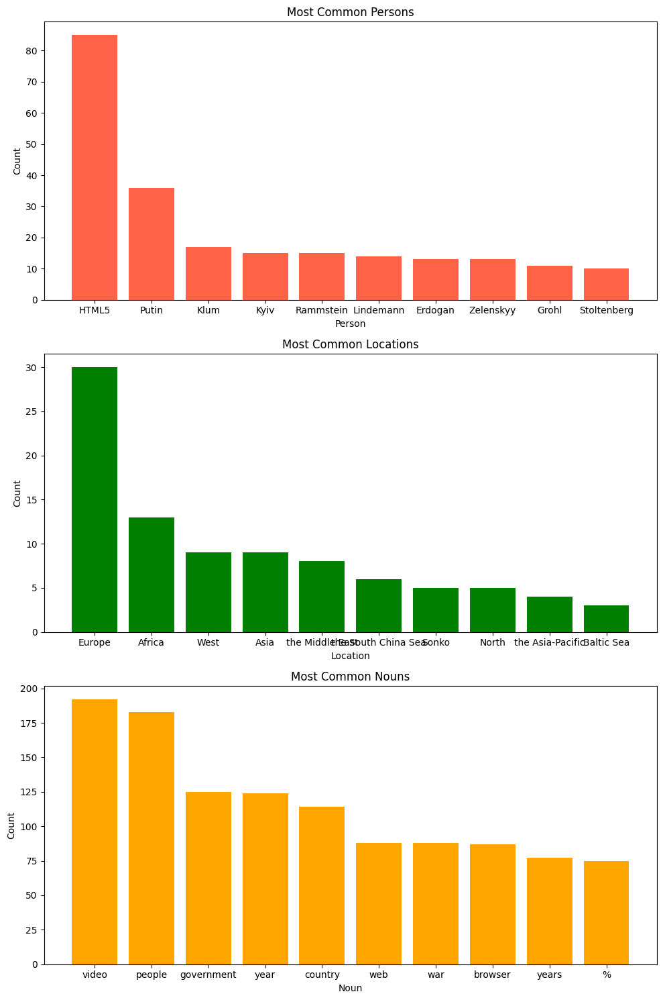

In [56]:
# Create bar plots for persons, locations, and nouns
fig, axs = plt.subplots(3, 1, figsize=(10, 15))

# Plot for persons
axs[0].bar(persons['person'].value_counts().head(10).index, persons['person'].value_counts().head(10), color='tomato')
axs[0].set_title('Most Common Persons')
axs[0].set_xlabel('Person')
axs[0].set_ylabel('Count')

# Plot for locations
axs[1].bar(locations['location'].value_counts().head(10).index, locations['location'].value_counts().head(10), color='green')
axs[1].set_title('Most Common Locations')
axs[1].set_xlabel('Location')
axs[1].set_ylabel('Count')

# Plot for nouns
axs[2].bar(nouns['nouns'].value_counts().head(10).index, nouns['nouns'].value_counts().head(10), color='orange')
axs[2].set_title('Most Common Nouns')
axs[2].set_xlabel('Noun')
axs[2].set_ylabel('Count')

# Adjust spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


# Exersice 3 🤠

We want to understand better, which persons are connected closely with each other. For this purpose, create a network of person co-occurrences and visualize it appropriately. Fine-tune the visualization. Try to find a good balance between providing rich and interesting information and not overloading the plot. Summarise in your own words: what are interesting and surprising insights that can be gained?

# Exersice 4 🤠

Create a network of person and location co-occurrences. Visualize and finetune the visualization in a similar way as above to make it as informative as possible. Summarise in your own words: what are interesting and surprising insights that can be gained?